# Script for Plotting Monthly Average Precipitation data for 2015 - 2065 and Generating an Animation
**Description:** Generates animations for average monthly rain number concentration for 2015 - 2064 for data from CESM, CMIP6, and comparison of the two  
**Input Data:** CESM2, CMIP6  
**Output Data:** Animations of ANRAIN  
**Creator:** Emma Perkins  
**Date:** June 2022

In [1]:
# loading in relevant packages
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
!pip install imageio
import imageio
import os
import cartopy.crs as ccrs

In [2]:
# loading data
file_path = '/glade/campaign/cesm/development/pcwg/projects/arctic_cylones/rufmod_expts/b.e21.BSSP370.f09_g17.rufmod.003/atm/proc/tseries/month_1/'
file_name = 'b.e21.BSSP370.f09_g17.rufmod.003.cam.h0.ANRAIN.201501-206412.nc'
with xr.open_dataset(file_path+file_name) as cesm_data:
    print(cesm_data)

FileNotFoundError: [Errno 2] No such file or directory: b'/glade/campaign/cesm/development/pcwg/projects/arctic_cylones/rufmod_expts/b.e21.BSSP370.f09_g17.rufmod.003/atm/proc/tseries/month_1/b.e21.BSSP370.f09_g17.rufmod.003.cam.h0.ANRAIN.201501-206412.nc'

In [3]:
# extracting variables of interest
cesm_rain = cesm_data.ANRAIN
print(cesm_rain)

# reformatting rain to look at surface rain
cesm_rain_surface = cesm_rain.isel(lev=len(cesm_rain.lev)-1)
print(cesm_rain_surface.dims)  # we can see that the array now has dimensions time, lat, lon

<xarray.DataArray 'ANRAIN' (time: 600, lev: 32, lat: 192, lon: 288)>
[1061683200 values with dtype=float32]
Coordinates:
  * lat      (lat) float64 -90.0 -89.06 -88.12 -87.17 ... 87.17 88.12 89.06 90.0
  * lon      (lon) float64 0.0 1.25 2.5 3.75 5.0 ... 355.0 356.2 357.5 358.8
  * lev      (lev) float64 3.643 7.595 14.36 24.61 ... 936.2 957.5 976.3 992.6
  * time     (time) object 2015-02-01 00:00:00 ... 2065-01-01 00:00:00
Attributes:
    mdims:         1
    units:         m-3
    long_name:     Average rain number conc
    cell_methods:  time: mean
('time', 'lat', 'lon')


In [4]:
# plotting surface rain for one month
cesm_rain0 = cesm_rain_surface.isel(time=0)
print(cesm_rain0)

<xarray.DataArray 'ANRAIN' (lat: 192, lon: 288)>
array([[ 757.2962 ,  757.2958 ,  757.2954 , ...,  757.29675,  757.29663,
         757.2964 ],
       [ 876.00977,  868.1869 ,  858.9687 , ...,  905.9828 ,  889.91705,
         882.5793 ],
       [1249.3799 , 1222.6819 , 1193.5529 , ..., 1303.2288 , 1289.4974 ,
        1272.6545 ],
       ...,
       [ 978.8438 ,  990.00256, 1005.96893, ...,  944.5324 ,  958.93384,
         969.01166],
       [ 166.40663,  183.33588,  179.65999, ...,  126.63634,  135.27377,
         150.47052],
       [ 195.3475 ,  195.34479,  195.34235, ...,  195.35748,  195.35384,
         195.35052]], dtype=float32)
Coordinates:
  * lat      (lat) float64 -90.0 -89.06 -88.12 -87.17 ... 87.17 88.12 89.06 90.0
  * lon      (lon) float64 0.0 1.25 2.5 3.75 5.0 ... 355.0 356.2 357.5 358.8
    lev      float64 992.6
    time     object 2015-02-01 00:00:00
Attributes:
    mdims:         1
    units:         m-3
    long_name:     Average rain number conc
    cell_methods:  ti

In [5]:
# find min and max values for plot color levels
cesm_rain0_max = np.amax(cesm_rain0)
print(cesm_rain0_max)
cesm_rain0_min = np.amin(cesm_rain0)
print(cesm_rain0_min)

<xarray.DataArray 'ANRAIN' ()>
array(45839.1015625)
Coordinates:
    lev      float64 992.6
    time     object 2015-02-01 00:00:00
<xarray.DataArray 'ANRAIN' ()>
array(0.)
Coordinates:
    lev      float64 992.6
    time     object 2015-02-01 00:00:00


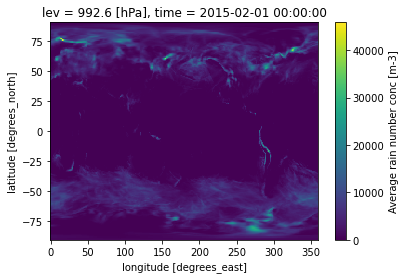

In [6]:
# rudimentary plot
cesm_rain0.plot()

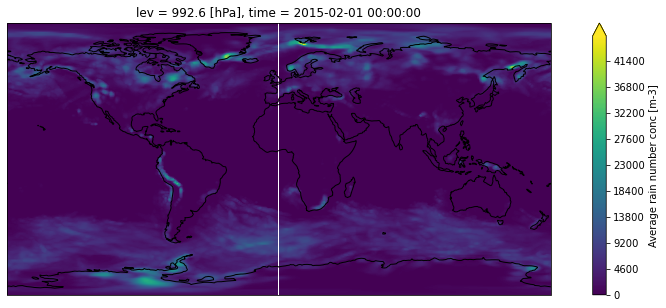

In [7]:
# make the plot better
cmap1 = plt.cm.viridis
lev1 = np.arange(0, cesm_rain0_max, 100)
fig1 = plt.figure(figsize=(15, 5))
ax1 = plt.axes(projection=ccrs.PlateCarree())
cesm_rain0.plot.contourf(ax=ax1, transform=ccrs.PlateCarree(), levels=lev1,
                         cmap=cmap1, add_colorbar=True)
ax1.coastlines()

In [12]:
# function to plot and save monthly precipitation
def map_plot(ds, i, minimum, maximum, color):
    fig1 = plt.figure(figsize=(15, 5))
    cmap1 = color
    lev1 = np.arange(minimum, maximum, 100)
    ax1 = plt.axes(projection=ccrs.PlateCarree())
    ds.isel(time=i).plot.contourf(ax=ax1, transform=ccrs.PlateCarree(),
                                  levels=lev1, cmap=cmap1, add_colorbar=True)
    ax1.coastlines()
    plt.savefig(str(i)+'.png')
    plt.close()

In [9]:
# function to animate plots
def animate(name, image_list):
    with imageio.get_writer(name, mode='I') as writer:
        for filename in image_list:
            image = imageio.imread(filename)
            writer.append_data(image)
    # delete images after using
    for filename in set(image_list):
        os.remove(filename)

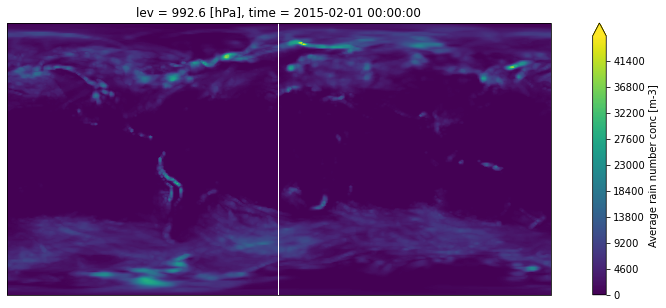

In [10]:
# test our function
map_plot(cesm_rain_surface, 0, 0, np.amax(cesm_rain0), plt.cm.viridis)

/glade/work/eperkins/miniconda3/envs/analysis3/lib/python3.7/site-packages/ipykernel_launcher.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning dissapear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  """


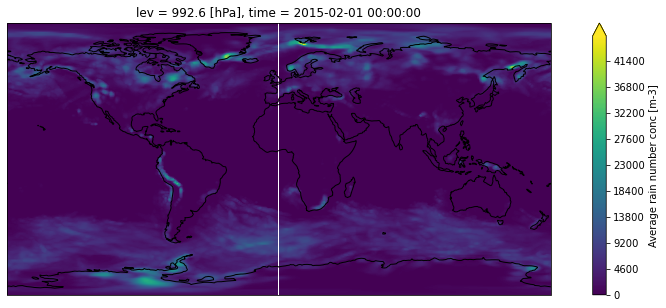

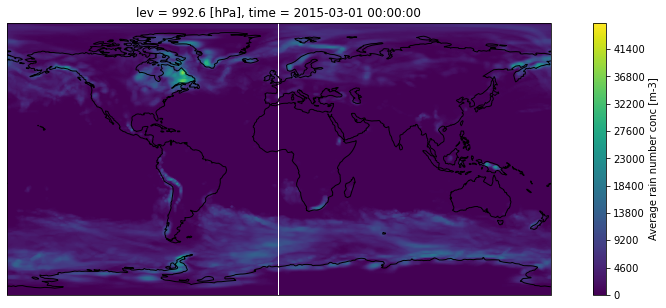

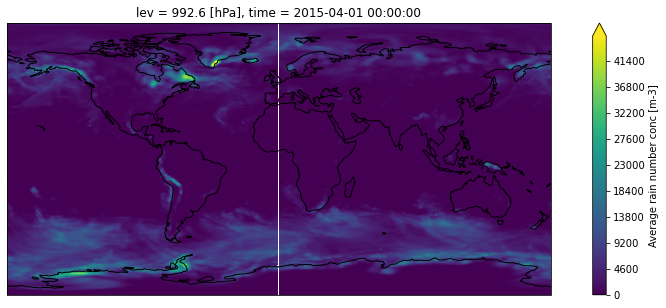

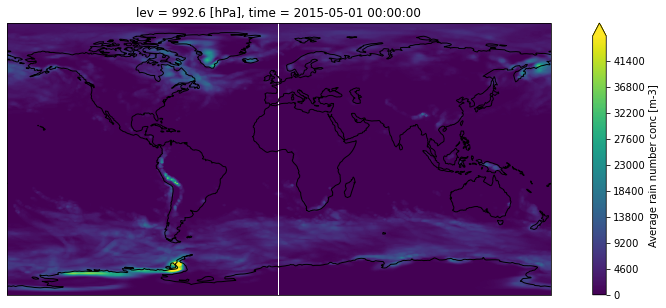

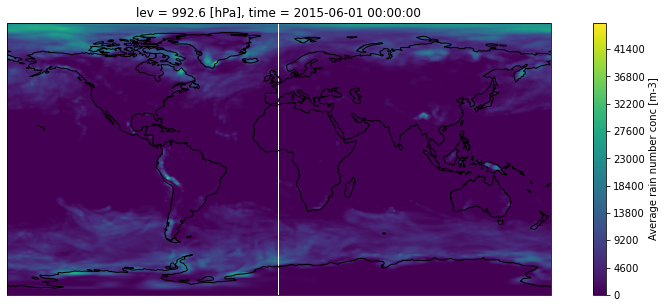

...

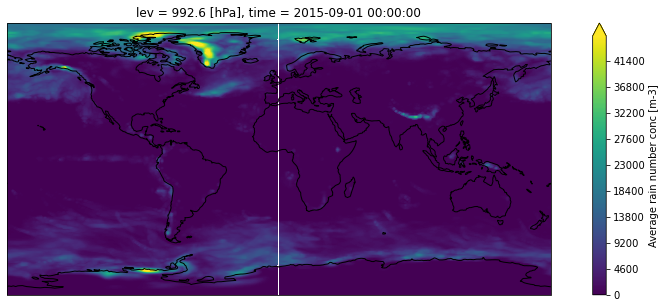

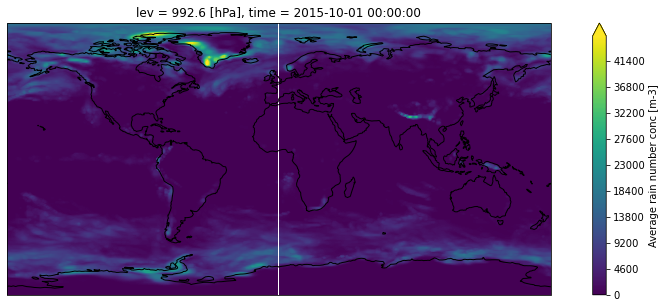

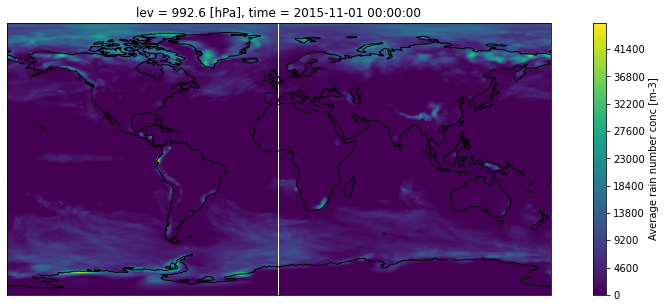

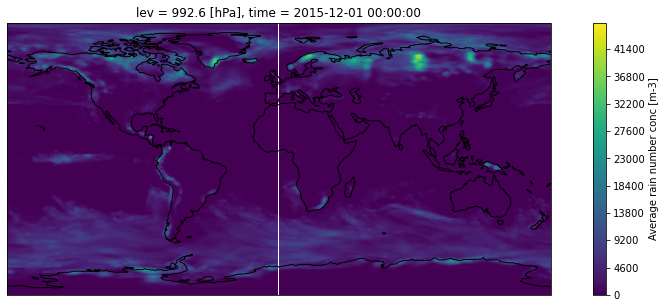

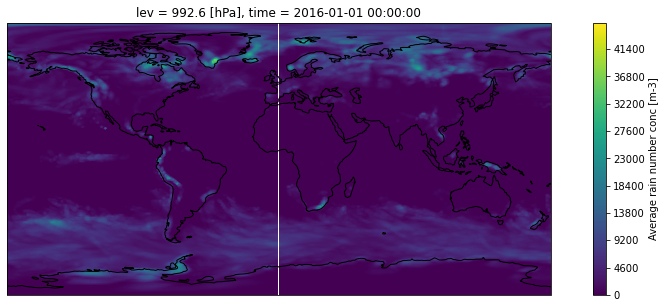

In [13]:
# saving plots for each month of 2015 (takes ~10 mins)
filenames = []
for i in range(0, 12):
    map_plot(cesm_rain_surface, i, np.amin(cesm_rain0), np.amax(cesm_rain0),
             plt.cm.viridis)
    filenames.append(str(i)+'.png')

# build animation
animate('cesm_precip_surface.gif', filenames)

/glade/work/eperkins/miniconda3/envs/analysis3/lib/python3.7/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


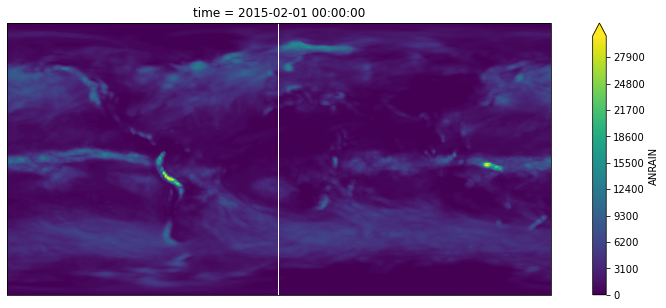

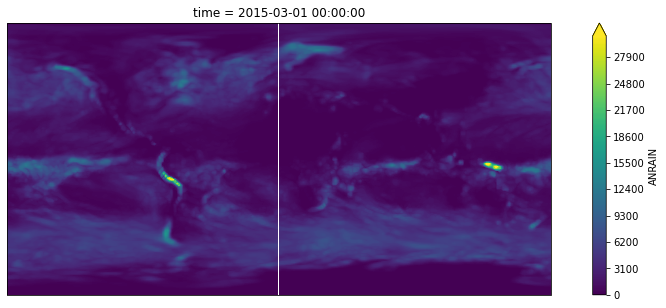

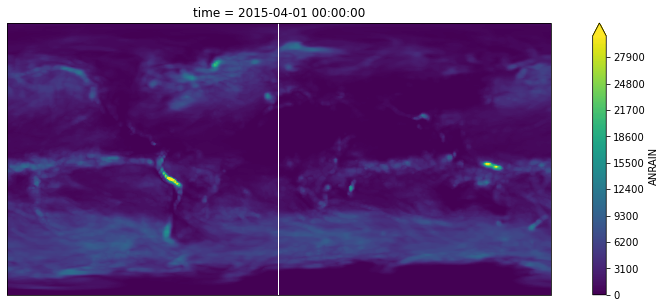

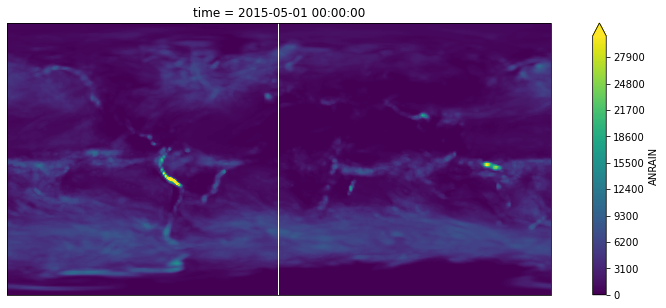

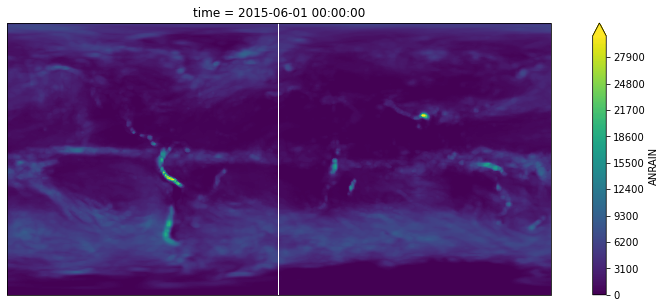

...

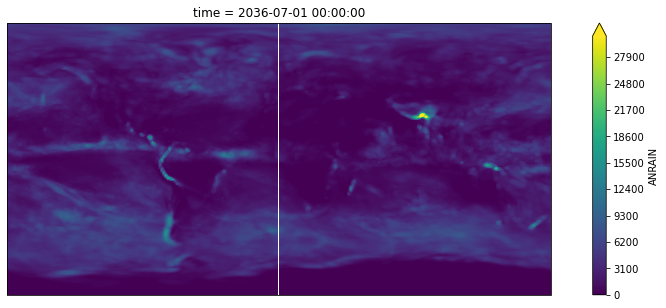

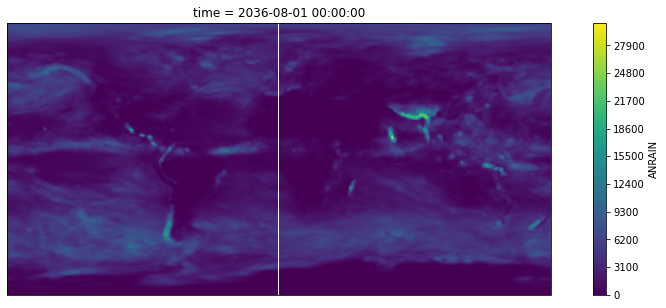

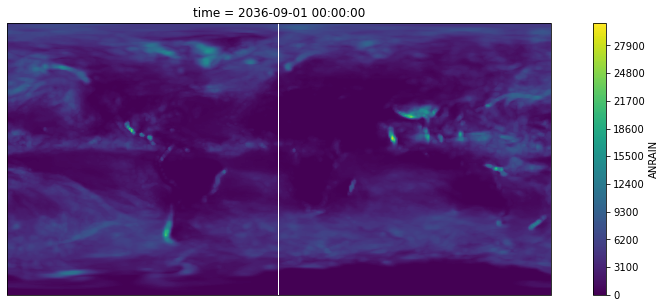

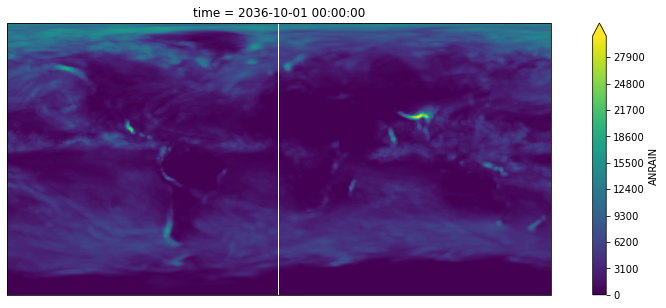

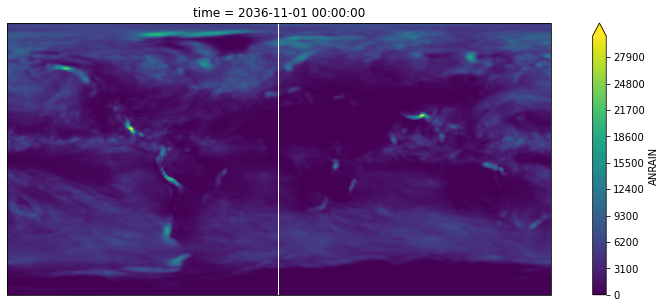

Error in callback <function flush_figures at 0x2ab9038d95f0> (for post_execute):


KeyboardInterrupt: 

In [24]:
# saving plots for each month of available data
# long step -- takes ~3 hours
filenames_full = []
for i in range(0, len(cesm_rain_surface.time)-1):
    map_plot(cesm_rain_surface, i, np.amin(cesm_rain0), np.amax(cesm_rain0),
             plt.cm.viridis)
    filenames_full.append(str(i)+'.png')

# build animation
animate('cesm_precip_surface_full.gif', filenames)

## Compare CESM data with CMIP6

In [14]:
# load cmip 6 data
file_path = '/glade/campaign/collections/cmip/CMIP6/timeseries-cmip6/b.e21.BSSP370cmip6.f09_g17.CMIP6-SSP3-7.0.101/atm/proc/tseries/month_1/'
file_name = 'b.e21.BSSP370cmip6.f09_g17.CMIP6-SSP3-7.0.101.cam.h0.ANRAIN.201501-206412.nc'
with xr.open_dataset(file_path+file_name) as cmip6_data:
    print(cmip6_data)

<xarray.Dataset>
Dimensions:       (lat: 192, zlon: 1, nbnd: 2, lon: 288, lev: 32, ilev: 33, time: 600)
Coordinates:
  * lat           (lat) float64 -90.0 -89.06 -88.12 -87.17 ... 88.12 89.06 90.0
  * zlon          (zlon) float64 0.0
  * lon           (lon) float64 0.0 1.25 2.5 3.75 ... 355.0 356.2 357.5 358.8
  * lev           (lev) float64 3.643 7.595 14.36 24.61 ... 957.5 976.3 992.6
  * ilev          (ilev) float64 2.255 5.032 10.16 18.56 ... 967.5 985.1 1e+03
  * time          (time) object 2015-02-01 00:00:00 ... 2065-01-01 00:00:00
Dimensions without coordinates: nbnd
Data variables: (12/27)
    zlon_bnds     (zlon, nbnd) float64 ...
    gw            (lat) float64 ...
    hyam          (lev) float64 ...
    hybm          (lev) float64 ...
    P0            float64 ...
    hyai          (ilev) float64 ...
    ...            ...
    n2ovmr        (time) float64 ...
    f11vmr        (time) float64 ...
    f12vmr        (time) float64 ...
    sol_tsi       (time) float64 ...
    n

In [15]:
# extracting variables of interest
cmip6_rain = cmip6_data.ANRAIN
print(cmip6_rain)

# reformatting rain to look at average across levels
cmip6_rain_surface = cmip6_rain.isel(lev=len(cmip6_rain.lev)-1)
print(cmip6_rain_surface.dims)  # we can see that the array now has dimensions time, lat, lon

<xarray.DataArray 'ANRAIN' (time: 600, lev: 32, lat: 192, lon: 288)>
[1061683200 values with dtype=float32]
Coordinates:
  * lat      (lat) float64 -90.0 -89.06 -88.12 -87.17 ... 87.17 88.12 89.06 90.0
  * lon      (lon) float64 0.0 1.25 2.5 3.75 5.0 ... 355.0 356.2 357.5 358.8
  * lev      (lev) float64 3.643 7.595 14.36 24.61 ... 936.2 957.5 976.3 992.6
  * time     (time) object 2015-02-01 00:00:00 ... 2065-01-01 00:00:00
Attributes:
    mdims:         1
    units:         m-3
    long_name:     Average rain number conc
    cell_methods:  time: mean
('time', 'lat', 'lon')


### Plotting CMIP6 Data

/glade/work/eperkins/miniconda3/envs/analysis3/lib/python3.7/site-packages/ipykernel_launcher.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning dissapear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  """


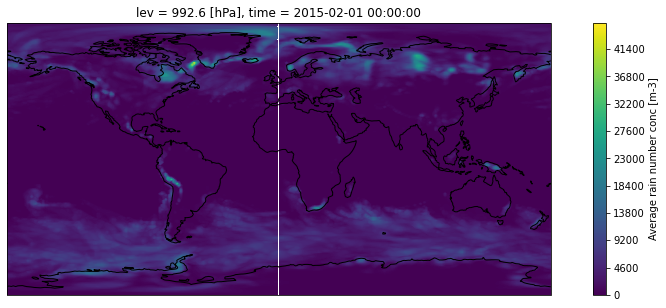

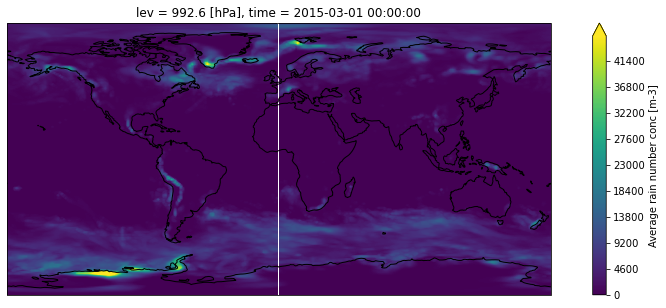

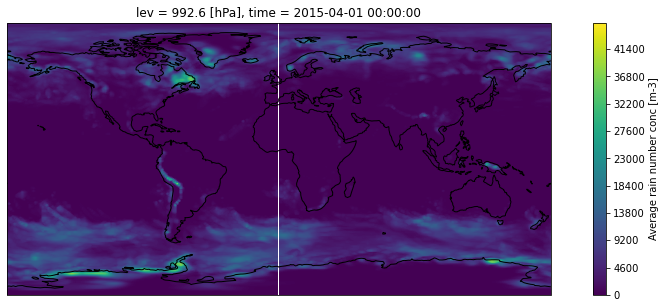

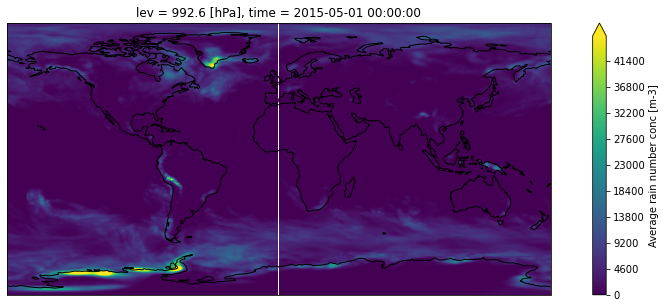

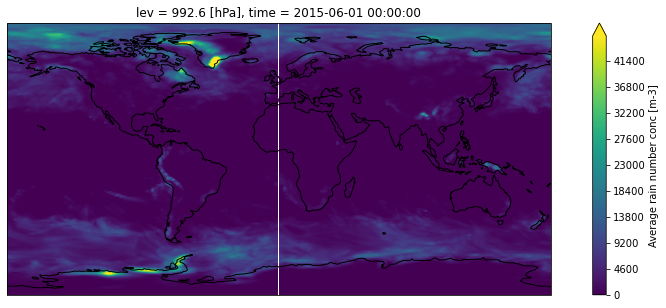

...

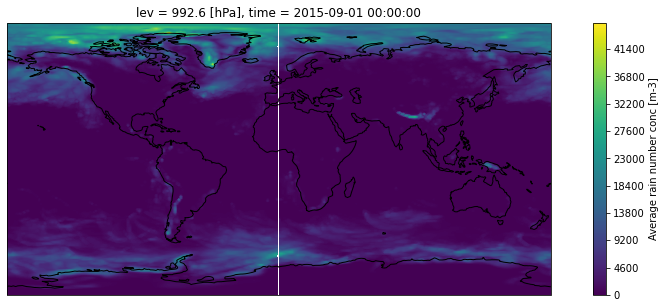

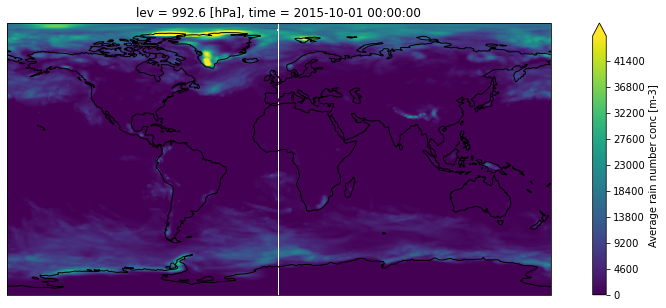

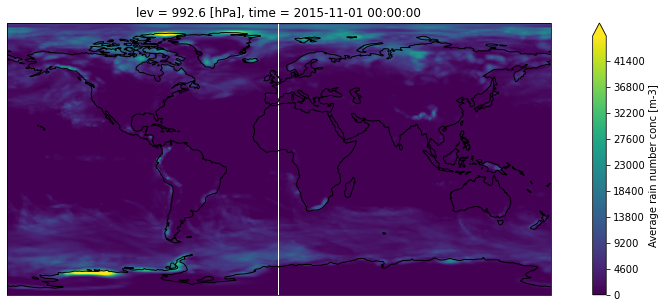

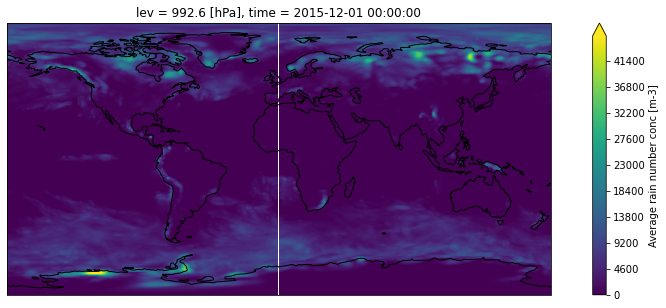

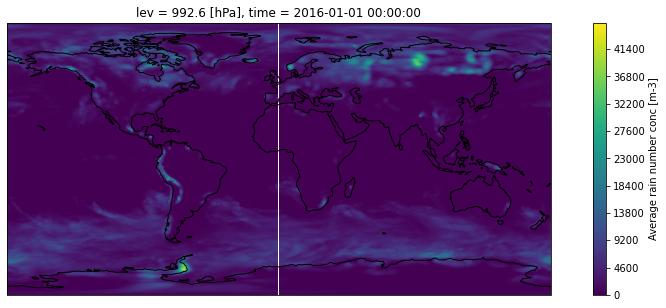

In [16]:
# saving plots for each month of 2015 (takes ~10 mins)
filenames = []
for i in range(0, 12):
    map_plot(cmip6_rain_surface, i, np.amin(cesm_rain0), np.amax(cesm_rain0),
             plt.cm.viridis)
    # plotting with same color axis as cesm for comparison
    filenames.append(str(i)+'.png')

# creating animation
animate('cmip6_precip_surface.gif', filenames)

### Plot difference between CMIP6 and CESM data

In [17]:
# take difference between models for rain at surface
rain_dif_surface = cmip6_rain_surface - cesm_rain_surface
print(rain_dif_surface)

<xarray.DataArray 'ANRAIN' (time: 600, lat: 192, lon: 288)>
array([[[-6.6581909e+02, -6.6585437e+02, -6.6578308e+02, ...,
         -6.6581659e+02, -6.6581647e+02, -6.6583301e+02],
        [-8.1429413e+02, -8.1016650e+02, -8.0527203e+02, ...,
         -8.3528833e+02, -8.2149939e+02, -8.1694800e+02],
        [-1.2492590e+03, -1.2225833e+03, -1.1934685e+03, ...,
         -1.3026848e+03, -1.2891379e+03, -1.2724391e+03],
        ...,
        [ 2.9021951e+03,  2.7280293e+03,  2.5464282e+03, ...,
          3.4641033e+03,  3.2447346e+03,  3.0794739e+03],
        [ 3.2384478e+03,  3.2047380e+03,  3.1748135e+03, ...,
          3.3542251e+03,  3.3151011e+03,  3.2807178e+03],
        [ 2.3421484e+03,  2.3421494e+03,  2.3421497e+03, ...,
          2.3421470e+03,  2.3421475e+03,  2.3421477e+03]],

       [[-6.2606502e-01, -6.2606609e-01, -6.2606579e-01, ...,
         -6.2606579e-01, -6.2606555e-01, -6.2606525e-01],
        [ 5.7950916e+00,  3.9348507e+00,  4.4086494e+00, ...,
          4.0593157e+00

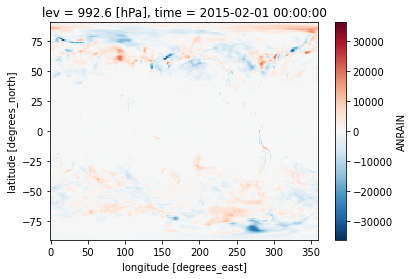

In [18]:
# rudimentary plot of difference
rain_dif_surface.isel(time=0).plot()

Text(0.5, 1.0, 'Difference between CMIP6 and CESM models for Annual Rain Number Concentraion - February 2015 (m^3)')

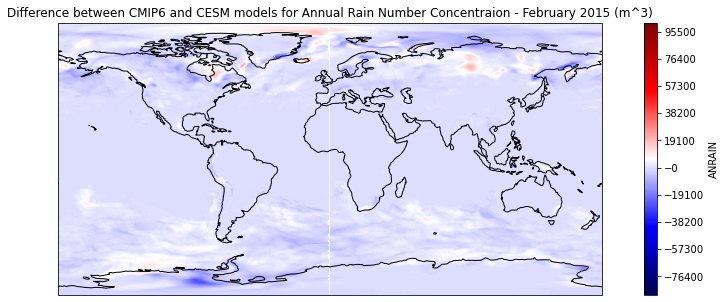

In [19]:
# more sophisticated plot of difference

cmap1 = plt.cm.seismic
lev1 = np.arange(np.amin(rain_dif_surface), np.amax(rain_dif_surface), 10)
fig1 = plt.figure(figsize=(15, 5))
ax1 = plt.axes(projection=ccrs.PlateCarree())
rain_dif_surface.isel(time=0).plot.contourf(ax=ax1,
                transform=ccrs.PlateCarree(), levels=lev1, cmap=cmap1, add_colorbar=True)
ax1.coastlines()
plt.title("Difference between CMIP6 and CESM models for Annual Rain Number Concentraion - February 2015 (m^3)")

as we can see in the image above, in most places CMIP6 predicts less rainfall at the surface than CESM for February 2015

/glade/work/eperkins/miniconda3/envs/analysis3/lib/python3.7/site-packages/ipykernel_launcher.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning dissapear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  """


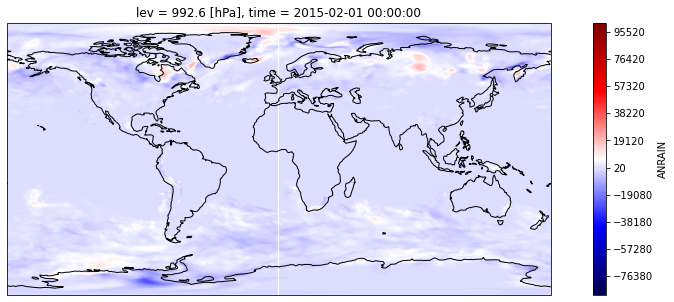

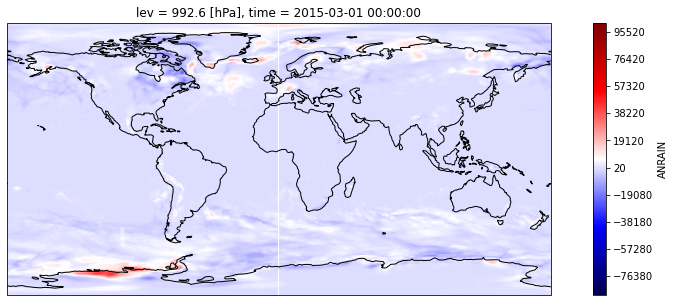

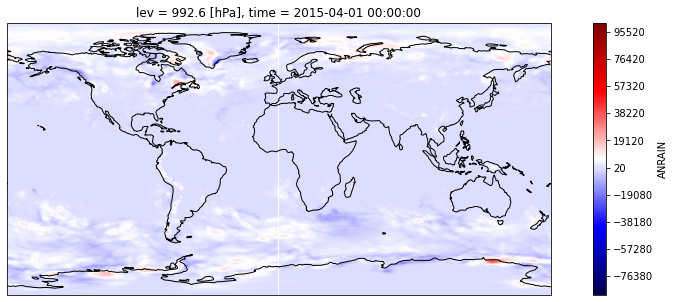

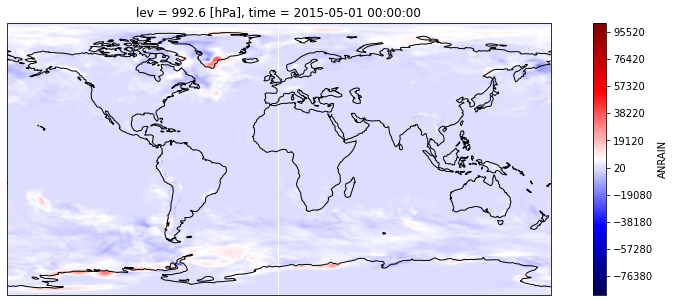

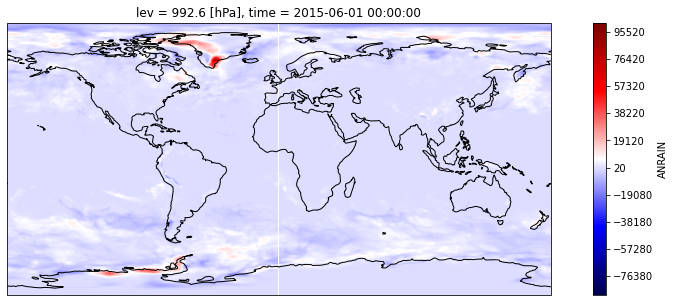

...

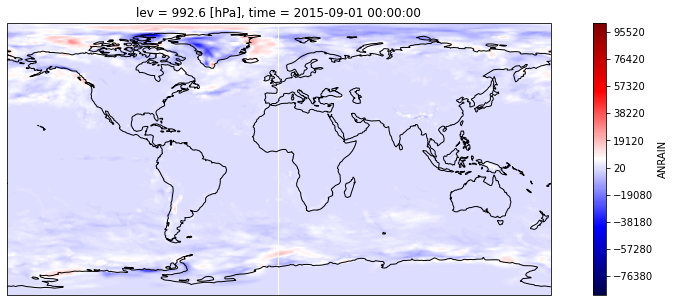

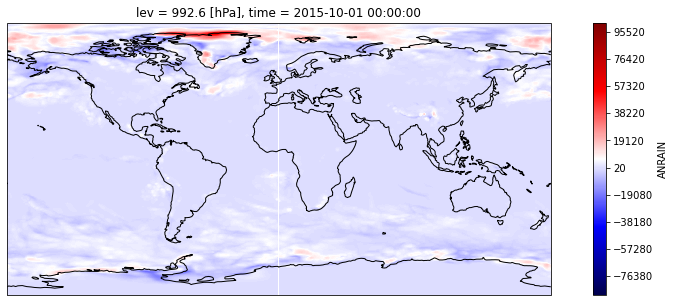

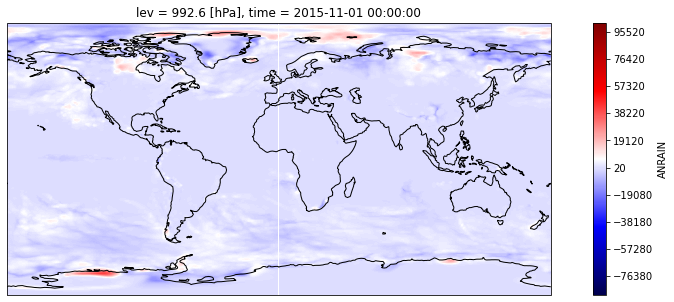

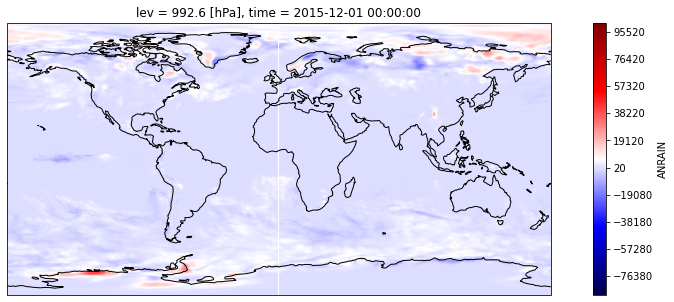

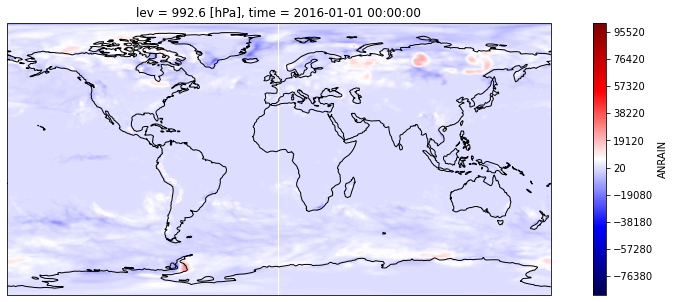

In [20]:
# compare cesm and cmip6 models across a whole year (takes about 10 mins)
filenames = []
for i in range(0, 12):
    map_plot(rain_dif_surface, i, np.amin(rain_dif_surface),
             np.amax(rain_dif_surface), plt.cm.seismic)
    filenames.append(str(i)+'.png')

# build animation
animate('surface_precip_comparison.gif', filenames)